**This notebook is used for brining examples needed for the report related to the ranking violence and discussion chapters**

In [1]:
from protestDB import cursor

In [44]:
pc = cursor.ProtestCursor()
imgs = pc.getLabelledImages(source = "UCLA",  label_source="UCLA original")

In [49]:
imgs

,name,source,filetype,timestamp,url,origin,position,label,ucla-test,ucla-train,...,respect,africa,loving,loves,england,venezuela,twitter,luca rossi,ecb,frankfurt
imageHASH,,,,,,,,,,,,,,,,,,,,,
030d92ca8d1f4b6b,test-00000.jpg,UCLA,.jpg,2018-02-13 16:53:13.868277,None,local,None,0.487873,True,False,...,False,False,False,False,False,False,False,False,False,False
94c4c6443cbc9c14,test-00002.jpg,UCLA,.jpg,2018-02-13 16:53:15.207416,None,local,None,0.285790,True,False,...,False,False,False,False,False,False,False,False,False,False
0b2cf29e92aa294f,test-00010.jpg,UCLA,.jpg,2018-02-13 16:53:16.176425,None,local,None,0.433110,True,False,...,False,False,False,False,False,False,False,False,False,False
160335f46456562e,test-00013.jpg,UCLA,.jpg,2018-02-13 16:53:17.113019,None,local,None,0.251941,True,False,...,False,False,False,False,False,False,False,False,False,False
6a22e2626c464360,test-00020.jpg,UCLA,.jpg,2018-02-13 16:53:18.254185,None,local,None,0.287450,True,False,...,False,False,False,False,False,False,False,False,False,False
7864656be2a2260b,test-00028.jpg,UCLA,.jpg,2018-02-13 16:53:19.761568,None,local,None,0.392205,True,False,...,False,False,False,False,False,False,False,False,False,False
a494c469ac8e8ec4,test-00029.jpg,UCLA,.jpg,2018-02-13 16:53:20.351934,None,local,None,0.443350,True,False,...,False,False,False,False,False,False,False,False,False,False
94d0f7b39ebce000,test-00030.jpg,UCLA,.jpg,2018-02-13 16:53:20.940158,None,local,None,0.251407,True,False,...,False,False,False,False,False,False,False,False,False,False
195acace4e4b65c4,test-00037.jpg,UCLA,.jpg,2018-02-13 16:53:22.413582,None,local,None,0.436442,True,False,...,False,False,False,False,False,False,False,False,False,False


In [50]:
# normalize scores and order images
from lib import analysis_utils as au

cutpoint = 0.43
imgs = au.clipDFColumn(imgs, 'label', cutpoint)
imgs = au.minMax(imgs, 'label')
imgs_ordered = imgs.sort_values(by="label", ascending= True).reset_index()

In [51]:
imgs_ordered

,imageHASH,name,source,filetype,timestamp,url,origin,position,label,ucla-test,...,respect,africa,loving,loves,england,venezuela,twitter,luca rossi,ecb,frankfurt
0,4ace8a9aa459edcd,train-25352.jpg,UCLA,.jpg,2018-02-13 22:27:35.288729,None,local,None,0.000000,False,...,False,False,False,False,False,False,False,False,False,False
1,0f3313373b331f97,train-16756.jpg,UCLA,.jpg,2018-02-13 21:21:59.108758,None,local,None,0.039013,False,...,False,False,False,False,False,False,False,False,False,False
2,fe6e66e687e7d8be,train-19716.jpg,UCLA,.jpg,2018-02-13 21:44:31.685513,None,local,None,0.093287,False,...,False,False,False,False,False,False,False,False,False,False
3,2b2b3ad52b2b3171,train-08496.jpg,UCLA,.jpg,2018-02-13 20:20:19.176250,None,local,None,0.096390,False,...,False,False,False,False,False,False,False,False,False,False
4,c9c3b3b0b9ddce9c,test-01006.jpg,UCLA,.jpg,2018-02-13 16:57:47.039079,None,local,None,0.098808,True,...,False,False,False,False,False,False,False,False,False,False
5,884d217137313e6b,test-01842.jpg,UCLA,.jpg,2018-02-13 17:01:37.076502,None,local,None,0.103375,True,...,False,False,False,False,False,False,False,False,False,False
6,6064a8b67b31356a,train-08149.jpg,UCLA,.jpg,2018-02-13 20:17:40.689490,None,local,None,0.109103,False,...,False,False,False,False,False,False,False,False,False,False
7,4c4c6cdcd97b66c6,train-10061.jpg,UCLA,.jpg,2018-02-13 20:31:57.134661,None,local,None,0.111163,False,...,False,False,False,False,False,False,False,False,False,False
8,20a8b2d8d0f0d9dc,train-20526.jpg,UCLA,.jpg,2018-02-13 21:51:15.195558,None,local,None,0.113886,False,...,False,False,False,False,False,False,False,False,False,False
9,3025e543c8d02486,train-07506.jpg,UCLA,.jpg,2018-02-13 20:12:43.916279,None,local,None,0.119844,False,...,False,False,False,False,False,False,False,False,False,False


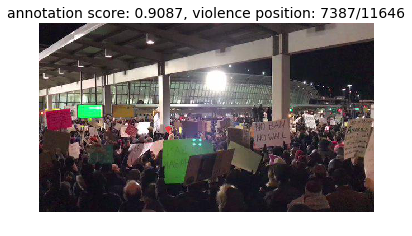

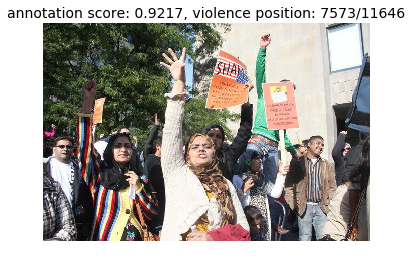

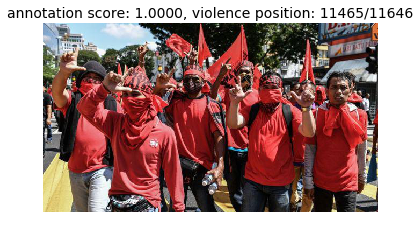

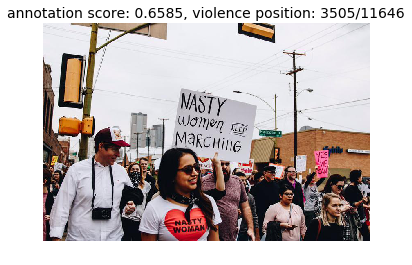

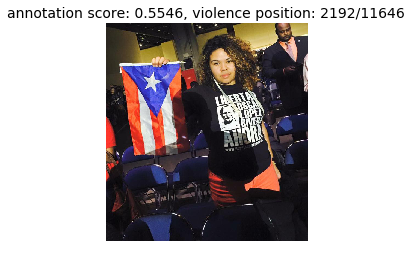

...

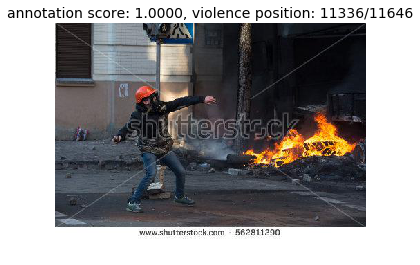

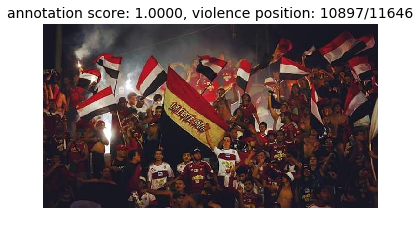

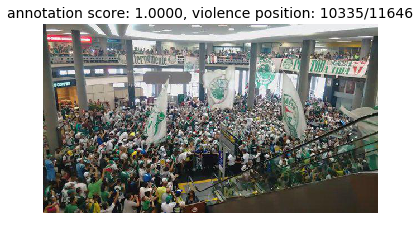

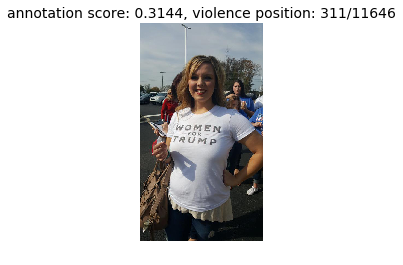

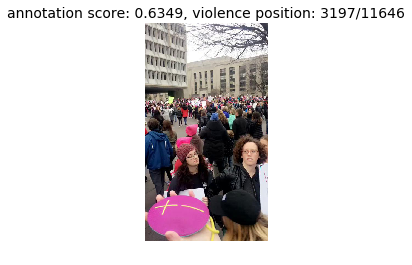

In [52]:
# print a few random images
import os
from PIL import Image
import matplotlib.pyplot as plt
seed = 200
random_images = imgs_ordered.sample(n=20, random_state=seed)
images_dir = "../images"

for indx, row in random_images.iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)), fontsize=14)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

** Take a look at specific parts**

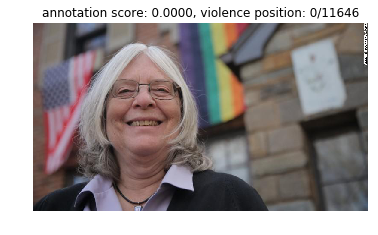

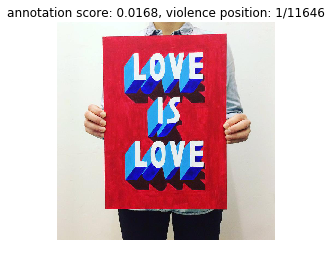

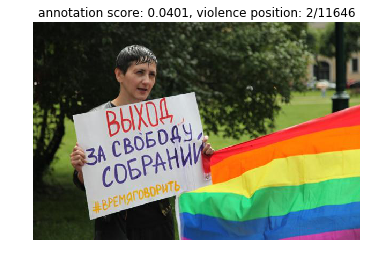

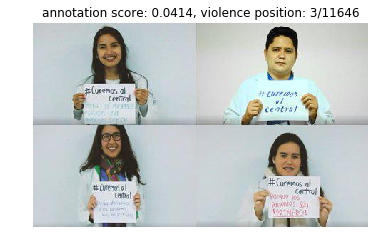

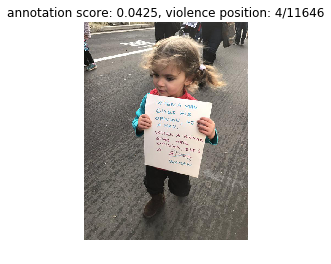

...

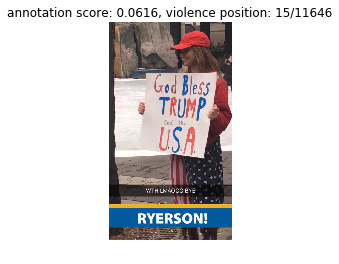

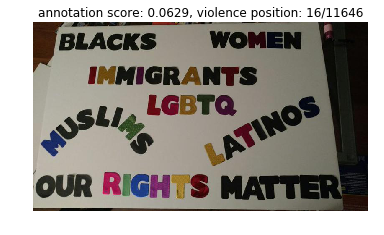

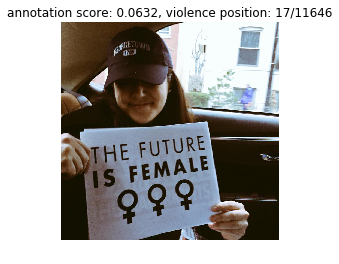

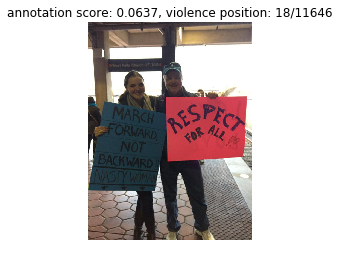

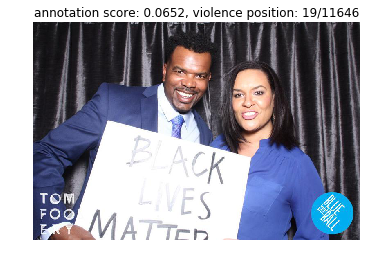

In [31]:

for indx, row in imgs_ordered[:20].iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

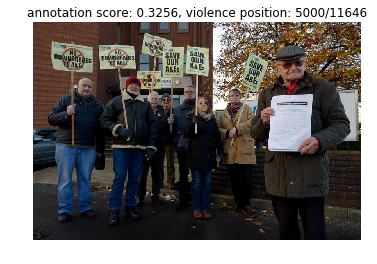

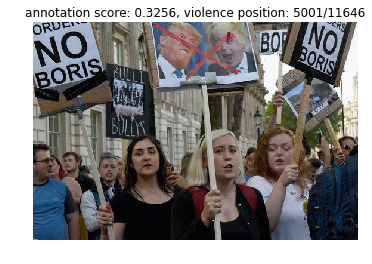

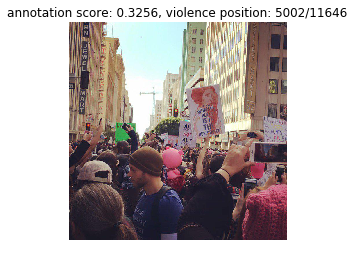

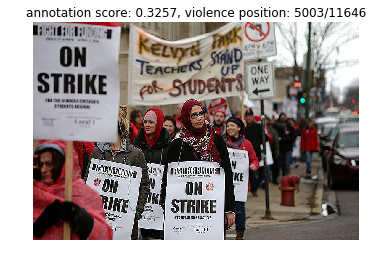

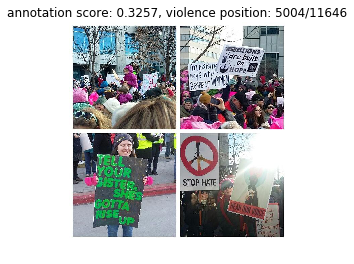

...

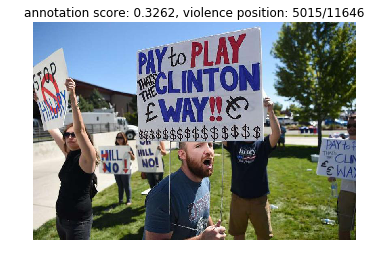

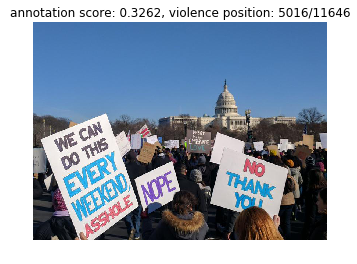

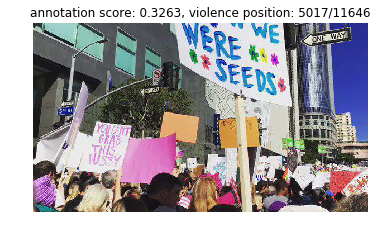

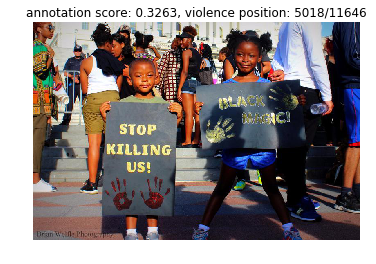

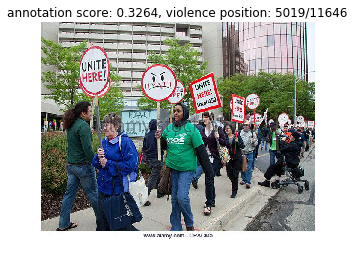

In [32]:
for indx, row in imgs_ordered[5000:5020].iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

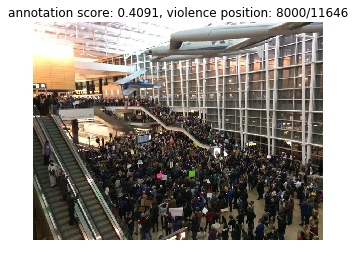

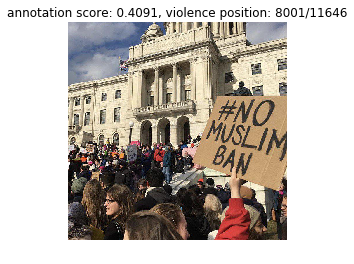

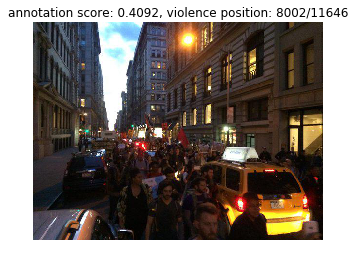

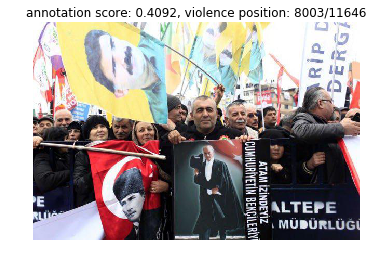

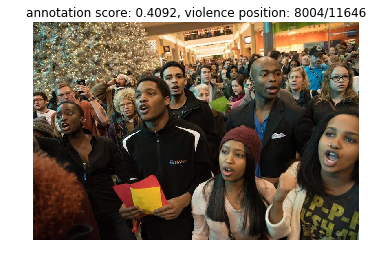

...

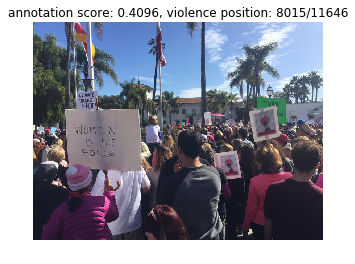

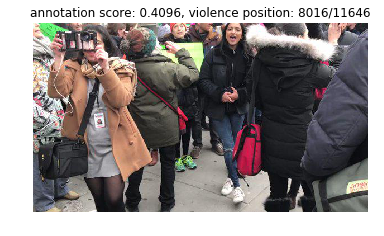

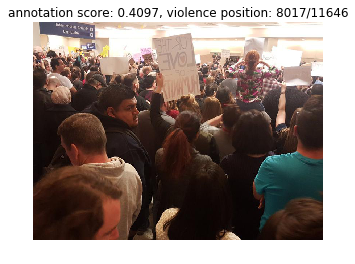

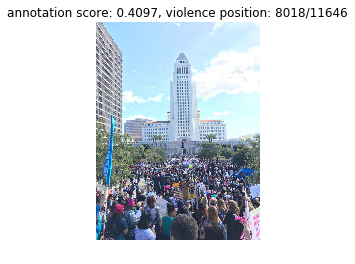

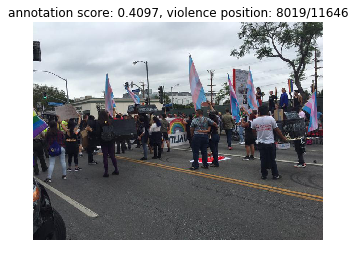

In [33]:
for indx, row in imgs_ordered[8000:8020].iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

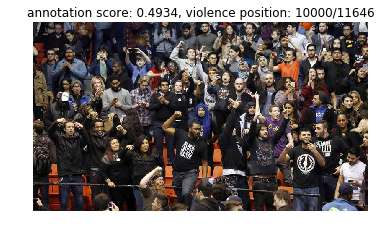

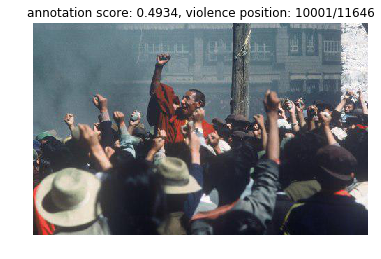

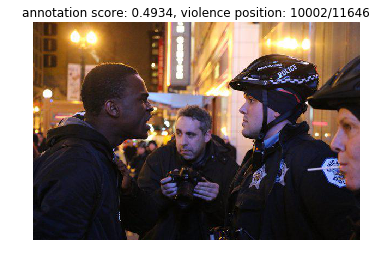

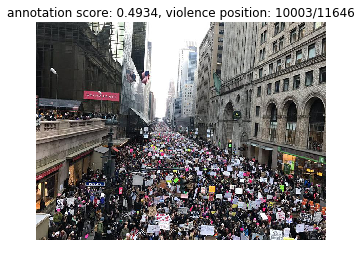

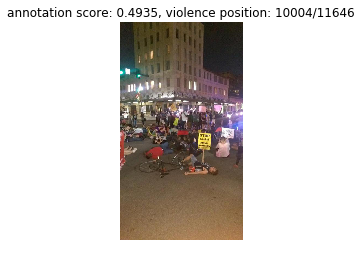

...

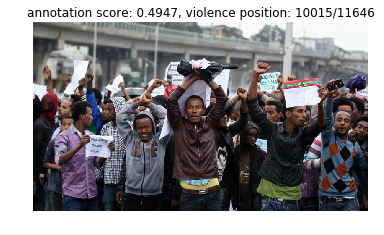

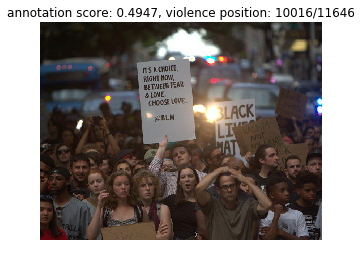

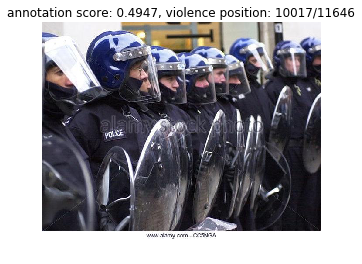

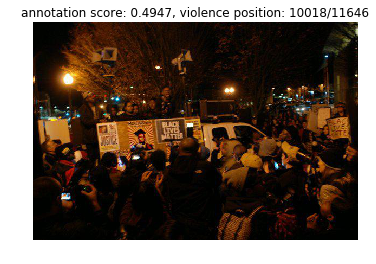

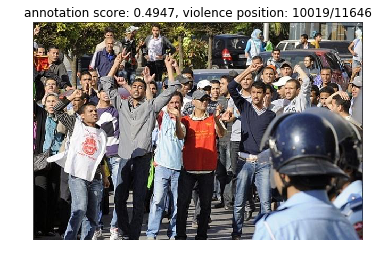

In [34]:
for indx, row in imgs_ordered[10000:10020].iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

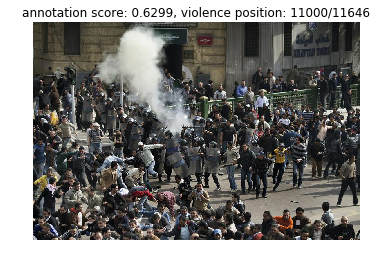

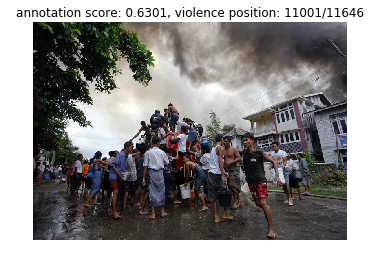

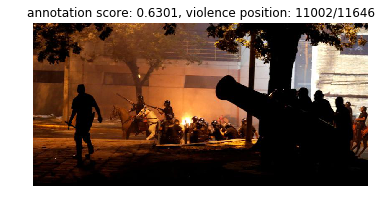

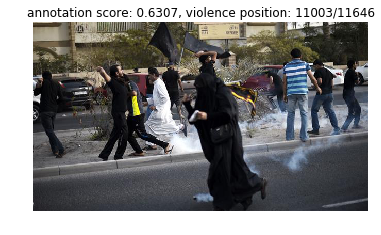

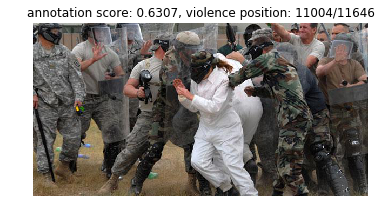

...

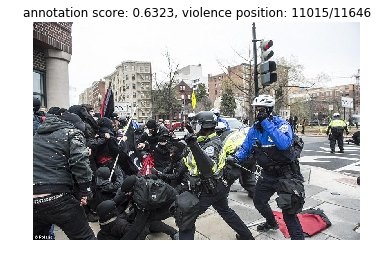

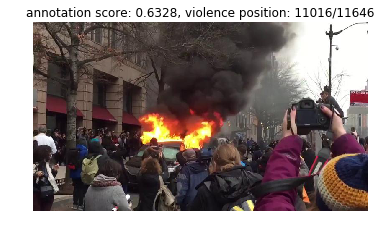

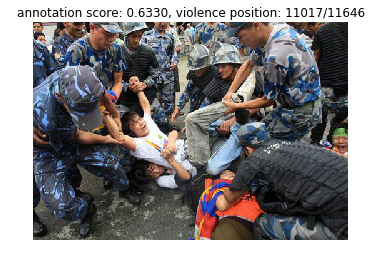

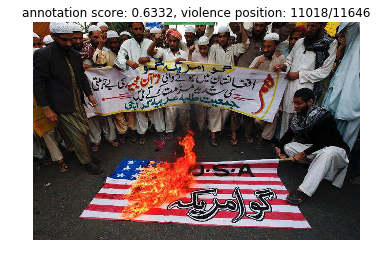

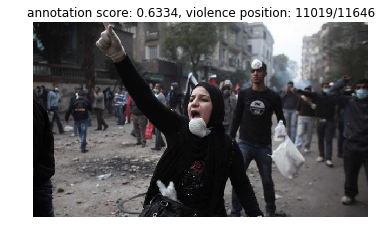

In [35]:
for indx, row in imgs_ordered[11000:11020].iterrows():
    path = os.path.join(images_dir, row['name'])
    img = Image.open(path)
    plt.title("annotation score: {:.4f}, violence position: {}/{}".format(row["label"], indx, len(imgs)))
    plt.imshow(img)
    plt.axis('off')
    plt.show()